# **Indian Sign Language Recognition**

## **Introduction**

*Sign language recognition is a problem that has been addressed in research for years. However, we are still far from finding a complete solution available in our society.*

<img src="https://miro.medium.com/max/1400/0*HTZoH3RiY7QT3lRe.jpeg" alt="sign-language">

*Among the works developed to address this problem, the majority of them have been based on basically two approaches: contact-based systems, such as sensor gloves; or vision-based systems, using only cameras. The latter is way cheaper and the boom of deep learning makes it more appealing.*

*This notebook presents a vision translation system for Indian sign language using LSTM neural network.*

## **Dataset**

We have used Indian Sign Language dataset provided by [India Sign Language Research and Training Centre](https://www.islrtc.nic.in/). The dataset contains 10,000 words with their signs recorded by multiple signers.

### **Pre Processing**

In [ ]:
import os
import csv
import shutil

In [ ]:
def rearrange_dataset(source_folder,destination):
  """
  Move data from ISLRTC to drive in structured manner
  """
  for path,dirs,files in os.walk(source_folder):
    for file in files:
      print(file)
      original_file=file
      file=file.lower()      
      if ".mp4" in file:
        word=file.replace(".mp4","")
        if os.path.exists(destination+"/"+word):
          file_no=len(os.listdir(destination+"/"+word))+1
        else:
          os.makedirs(destination+"/"+word,exist_ok=True)
          file_no=1
        
        shutil.copyfile(path+"/" +original_file,destination+"/"+word+"/"+str(file_no)+".mp4")

In [ ]:
data_source_path="drive/MyDrive/ISL/ISL Dictionary - 3rd edition (10000 terms)"
data_destiny_path="drive/MyDrive/ISL/old_Dataset"

In [ ]:
rearrange_dataset(data_source_path,data_destiny_path)

IMPORTANT.gdoc
Legal Terms List.docx
Legal Terms List.pdf
Abandonment of Child.mp4
Abdicate.mp4
Abortive Trial.mp4
Absolve.mp4
Accommodation Land.mp4
Acquaintance Rape , Date Rape , Marital Rape , Custodial Rape.mp4
Act of War.mp4
Adult.mp4
Apostasy.mp4
Birth Certificate.mp4
Co-accused.mp4
Contract Killing.mp4
Honor Killing or Shame Killing.mp4
Rent Control Act.mp4
Section 377 of IPC.mp4
Serial Killer.mp4
Serial Rapist.mp4
Abandonment of copyright.mp4
Assassination.mp4
Section 46(4) CrPC.mp4
Section 66 A IPC.mp4
Section 82 IPC.mp4
Section 97 IPC.mp4
Section 232 IPC.mp4
Section 302 IPC.mp4
Section 304 A IPC.mp4
Section 304 B IPC.mp4
Section 304 IPC.mp4
Section 306 IPC.mp4
Section 307 IPC.mp4
Section 312 IPC.mp4
Section 313 IPC.mp4
Section 314 IPC.mp4
Section 316 IPC.mp4
Section 317 IPC.mp4
Section 318 IPC.mp4
Section 370 IPC.mp4
Section 372 IPC.mp4
Section 374 IPC.mp4
Section 375.mp4
Section 376 A.mp4
Section 376 B.mp4
Section 376 C.mp4
Section 376 D.mp4
Section 376 E.mp4
Section 376.mp

In [ ]:
def seperate_words(word):
  duplicates_pattern = ['(','[','.',',']

  for i in duplicates_pattern:
    if (i == '(' or i=='[') and i in word:
      word = word[:word.index(i)]
      return seperate_words(word)
    elif i == '.' and i in word:
      if word[-1] == '.':
        word = word.replace('.','')
        return seperate_words(word)
      elif word[word.index(i)+1] == ' ':
        word = word.replace('.',',')
        return seperate_words(word)
      else:
        return word
    elif i == ',' and i in word:
      wordlist = [x.strip() for x in word.split(i)]
      return wordlist
  else:
    return word
  

def find_duplicates(folder):
  words = os.listdir(folder)
  words.sort()

  unique_words = {}

  duplicates_pattern = ['.', '(',')',',']
  for word in words:
    for pattern in duplicates_pattern:
      if pattern in word:
        nw = seperate_words(word)
        if type(nw) is list:
          for i in nw:
            if i in unique_words:
              unique_words[i].append(word)
            else:
              unique_words[i] = [word]
        else:
          if nw in unique_words:
            unique_words[nw].append(word)
          else:
            unique_words[nw] = [word]
        break
    else:
      if word[-2:].isdigit() == False and word[-1].isdigit() == True:
        if word[:-1] in unique_words:
          unique_words[word[:-1]].append(word)
        else:
          unique_words[word[:-1]] = [word]
      else:
        if word in unique_words:
          unique_words[word].append(word)
        else:
          unique_words[word] = [word]


  for k,v in sorted(unique_words.items()):
    print(k,":",v)

  with open(folder+'/duplicates.csv','w') as file:
    writer = csv.writer(file)
    writer.writerow(['Word', 'paths'])

    for k,v in unique_words.items():
      writer.writerow([k,v])

find_duplicates(data_destiny_path)

Streaming output truncated to the last 5000 lines.
abstain or abstention : ['abstain or abstention']
abstract : ['abstract']
abundant  : ['abundant (explanation)', 'abundant (sign and explanation)']
abusive language : ['abusive language']
abusive language  : ['abusive language 1']
ac : ['air conditioner, ac (split ac)', 'air conditioner, ac (window ac)']
ac express train : ['ac express train']
acacia fernesiana : ['acacia fernesiana']
acacia modesta : ['acacia modesta']
academic bank of credit  : ['academic bank of credit (abc)']
accelerator : ['accelerator']
accentuating : ['accentuating']
accept : ['accept']
acceptance letter : ['acceptance letter']
acceptance letter  : ['acceptance letter 1']
access : ['access, accessible']
accessible : ['access, accessible']
accessories : ['accessories']
accident : ['accident']
accident prone area : ['accident prone area']
acclimation : ['acclimation']
accommodation : ['accommodation']
accommodation endorsement : ['accommodation endorsement']
accom

In [ ]:
clean_data_path = 'drive/MyDrive/ISL/Dataset'

In [ ]:
import ast

def clean_data(old_folder, clean_data_path):
  with open(old_folder+'/duplicates.csv') as file:
    data = csv.reader(file)

    for row in data:
      word,paths = row
      if word == 'Word':
        continue
      file_no = 1
      paths = ast.literal_eval(paths)
      
      if not os.path.exists(clean_data_path+'/'+word):
        os.makedirs(clean_data_path+"/"+word,exist_ok=True)

        for i in paths:
          for path,dirs,files in os.walk(old_folder+'/'+i):
            for f in files:
              shutil.copyfile(path+'/'+f, clean_data_path+'/'+word+'/'+str(file_no)+'.mp4')
              file_no += 1      

clean_data(data_destiny_path, clean_data_path)

In [ ]:
# merge same words with different spacing
words = os.listdir(clean_data_path)
unique_words = list(set([x.rstrip(" ") for x in os.listdir(clean_data_path)]))

for i in unique_words:
  if  i in words:
    words.remove(i)

for word in words:
  for path,dirs,files in os.walk(clean_data_path+'/'+word):
    if os.path.exists(clean_data_path+'/'+word.rstrip(" ")):
      file_no = len(os.listdir(clean_data_path+'/'+word.rstrip(" ")))
      for  file in files:
        file_no += 1
        shutil.copyfile(path+'/'+file, clean_data_path+'/'+word.strip(" ")+'/'+str(file_no)+'.mp4')
      shutil.rmtree(clean_data_path+'/'+word)

In [ ]:
print(len(os.listdir(clean_data_path)))

8345


In [ ]:
# finding empty directories
for root, dirs, files in os.walk(clean_data_path):
    if not len(dirs) and not len(files):
        print(root)

### **Extract Keypoints using MediaPipe**

#### **Install and Import Dependencies**

In [ ]:
!pip install tensorflow tensorflow-gpu opencv-python mediapipe sklearn matplotlib

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     |████████████████████████████████| 511.7 MB 6.1 kB/s 
     |████████████████████████████████| 32.9 MB 1.3 MB/s 
     |████████████████████████████████| 511.7 MB 5.1 kB/s 
     |████████████████████████████████| 497.9 MB 18 kB/s 


In [ ]:
import cv2
import numpy as np
import os
from matplotlib import pyplot as plt
import time
import mediapipe as  mp # to extract keypoints from gesture and face
from google.colab.patches import cv2_imshow

#### **Extract and Save Keypoints Dataset**

In [ ]:
mp_holistic = mp.solutions.holistic # Holistic model
mp_drawing = mp.solutions.drawing_utils # Drawing utilities

In [ ]:
def mediapipe_detection(image, model):
  image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
  image.flags.writeable = False                 
  results = model.process(image)                 
  image.flags.writeable = True
  image = cv2.cvtColor(image, cv2.COLOR_RGB2BGR)
  return image, results

In [ ]:
def draw_landmarks(image, results):
  mp_drawing.draw_landmarks(image, results.face_landmarks, mp_holistic.FACEMESH_TESSELATION,
                            mp_drawing.DrawingSpec(color=(80,110,10), thickness=1, circle_radius=1),
                            mp_drawing.DrawingSpec(color=(80,256,121), thickness=1, circle_radius=1)) 
  
  mp_drawing.draw_landmarks(image, results.pose_landmarks, mp_holistic.POSE_CONNECTIONS,
                            mp_drawing.DrawingSpec(color=(80,22,10), thickness=2, circle_radius=4),
                            mp_drawing.DrawingSpec(color=(80,44,121), thickness=2, circle_radius=2)) 
  
  mp_drawing.draw_landmarks(image, results.left_hand_landmarks, mp_holistic.HAND_CONNECTIONS,
                            mp_drawing.DrawingSpec(color=(121,22,76), thickness=2, circle_radius=4),
                            mp_drawing.DrawingSpec(color=(121,44,250), thickness=2, circle_radius=2)) 
  
  mp_drawing.draw_landmarks(image, results.right_hand_landmarks, mp_holistic.HAND_CONNECTIONS,
                            mp_drawing.DrawingSpec(color=(245,117,66), thickness=2, circle_radius=4),
                            mp_drawing.DrawingSpec(color=(245,66,230), thickness=2, circle_radius=2)) 

In [ ]:
def visualize(video_path):
  cap = cv2.VideoCapture(video_path)

  with mp_holistic.Holistic(min_detection_confidence=0.5, min_tracking_confidence=0.5) as holistic:
    while cap.isOpened():
      ret, frame = cap.read()
      
      image, results = mediapipe_detection(frame, holistic)
      # print(results)
     
      draw_landmarks(image, results)
      # print(results)

      cv2_imshow(image)
      
      if cv2.waitKey(10) & 0xFF == ord('q'):
            break
  cap.release()
  cv2.destroyAllWindows()

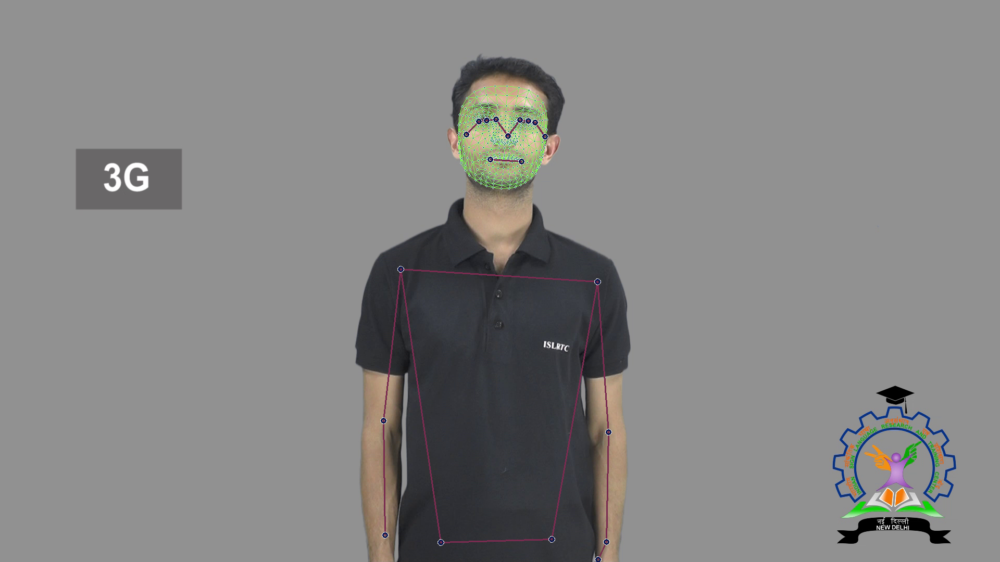

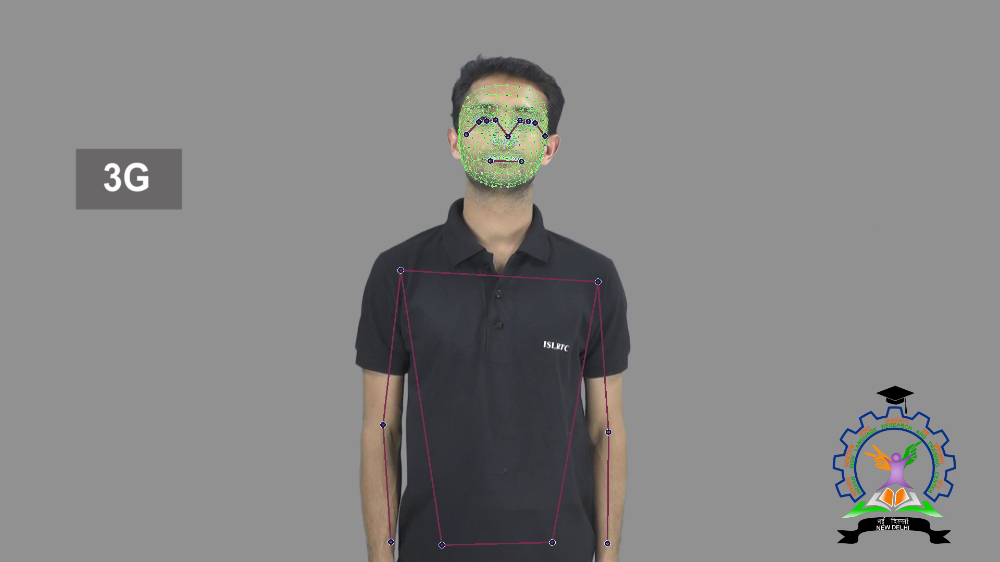

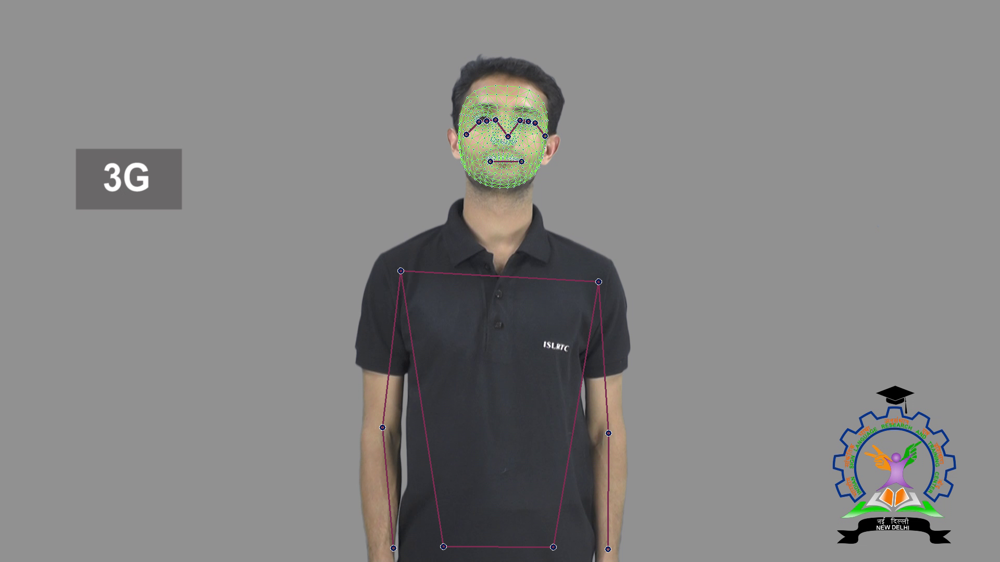

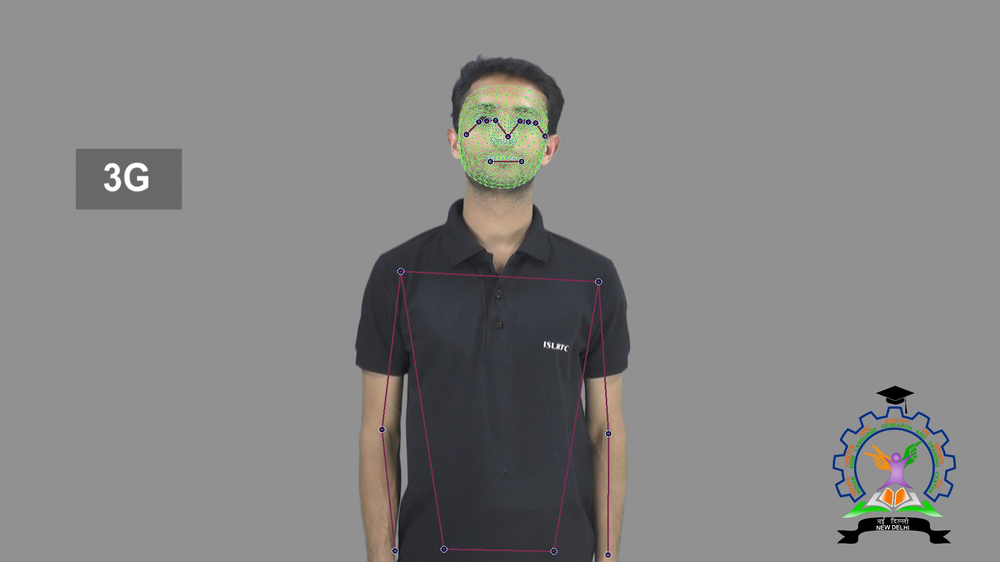

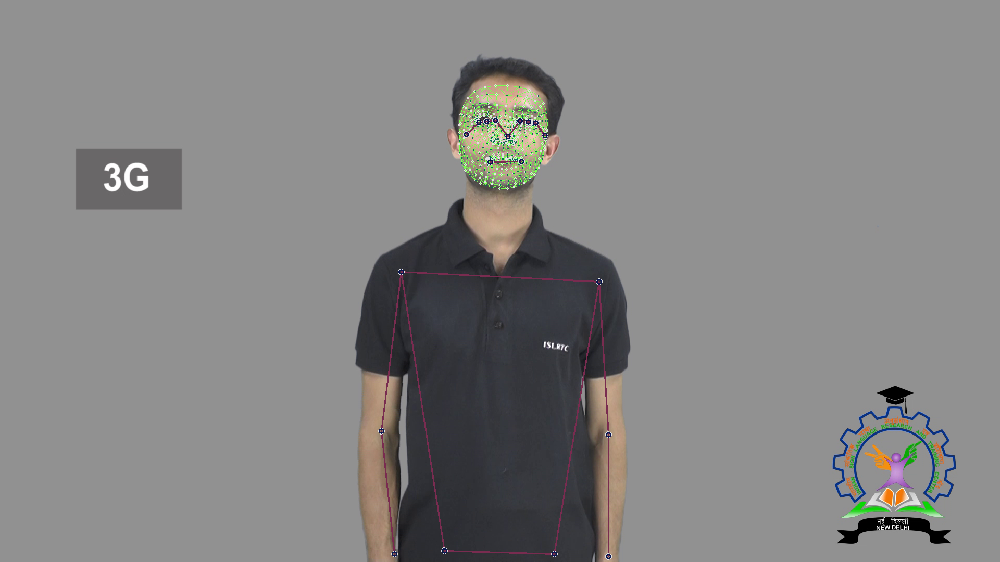

...

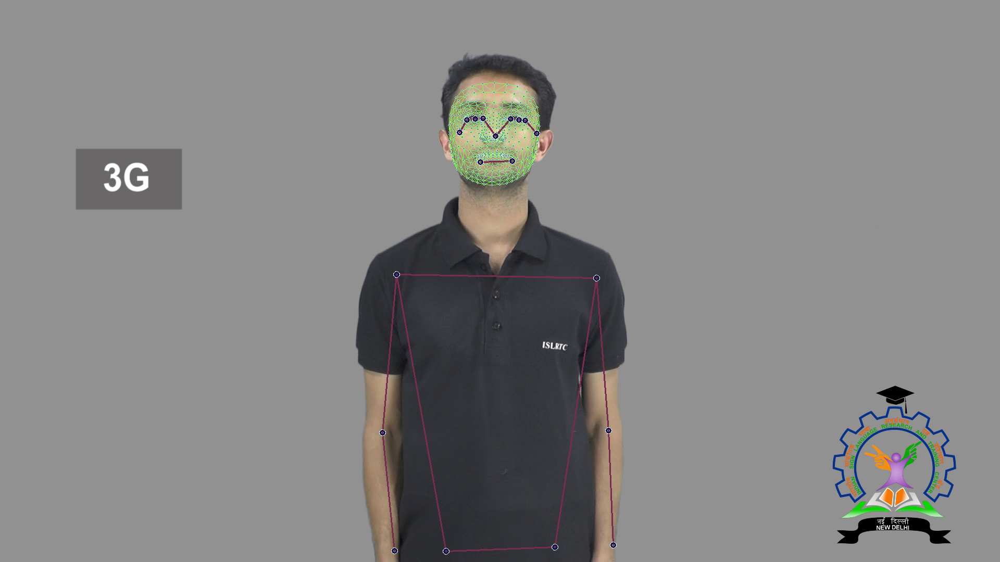

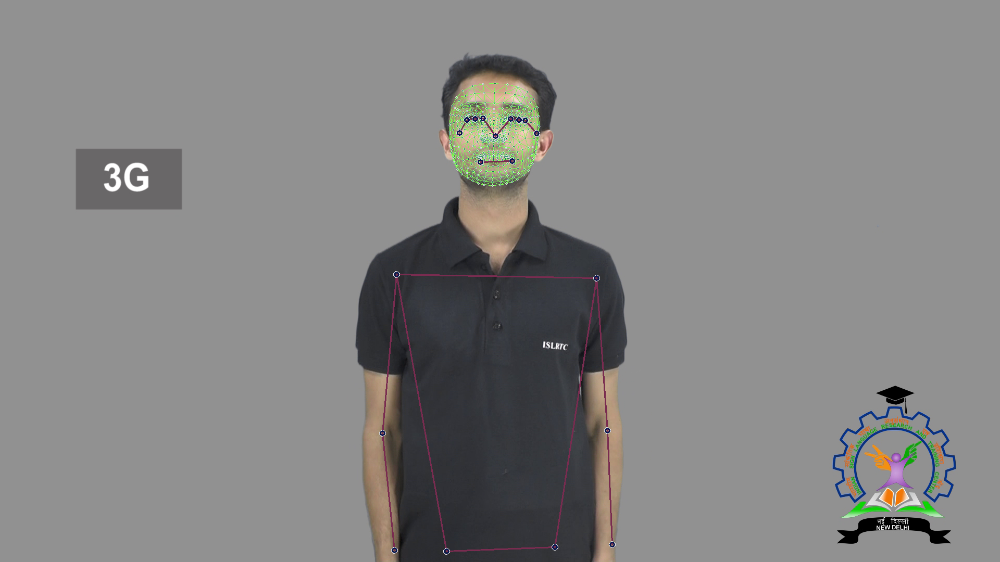

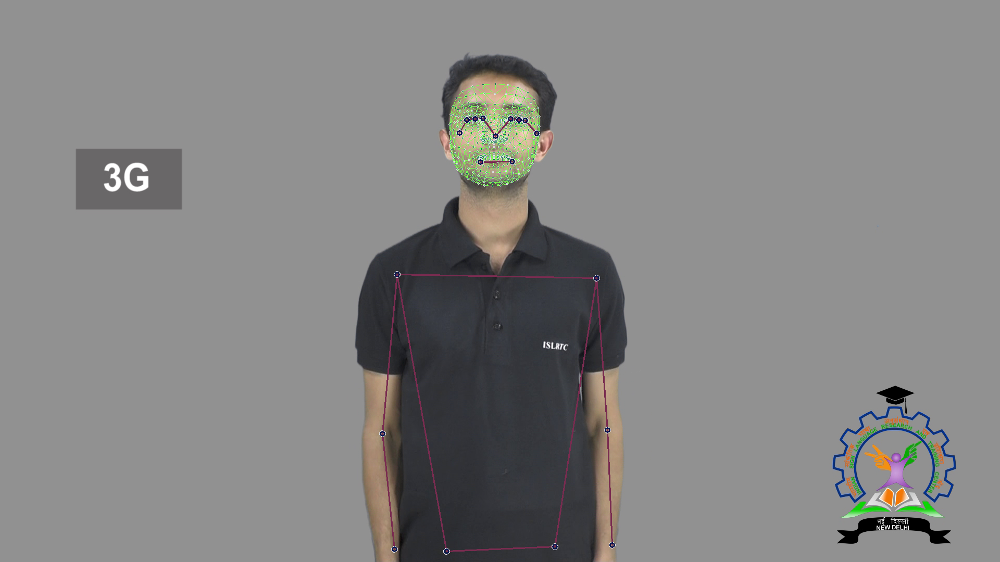

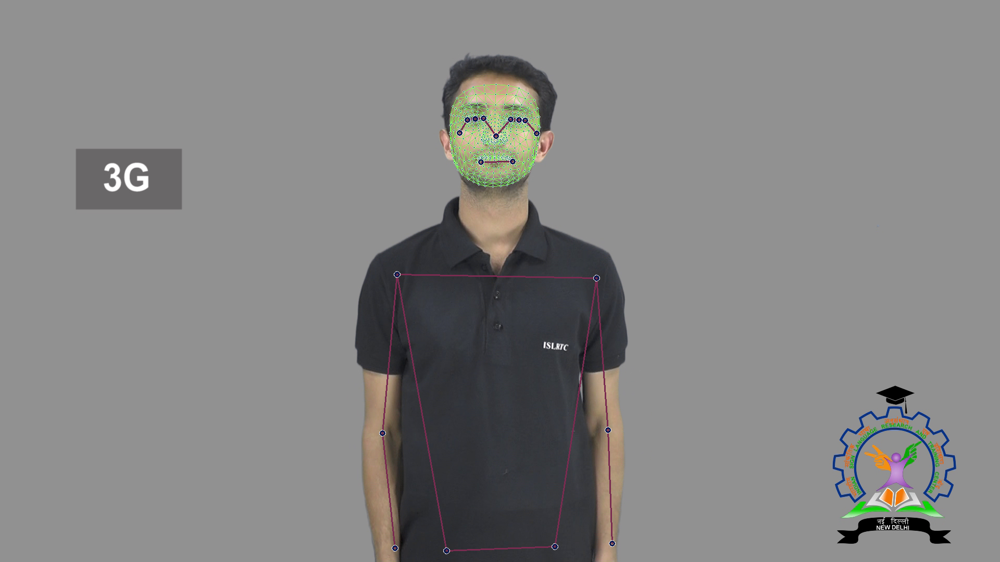

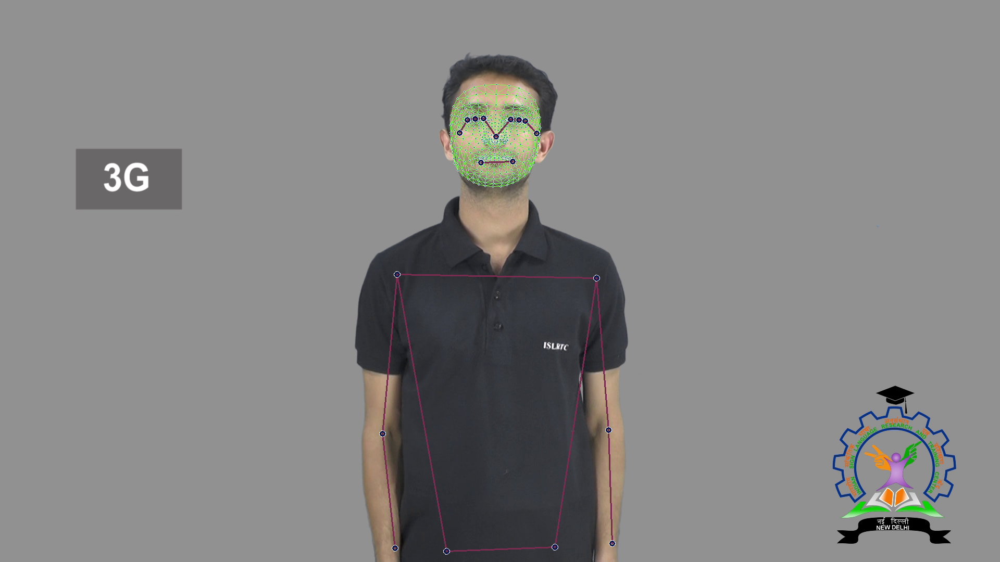

error: ignored

In [ ]:
visualize(clean_data_path+'/3g/1.mp4')

In [ ]:
def extract_keypoints(results):
    pose = np.array([[res.x, res.y, res.z, res.visibility] for res in results.pose_landmarks.landmark]).flatten() if results.pose_landmarks else np.zeros(33*4)
    face = np.array([[res.x, res.y, res.z] for res in results.face_landmarks.landmark]).flatten() if results.face_landmarks else np.zeros(468*3)
    lh = np.array([[res.x, res.y, res.z] for res in results.left_hand_landmarks.landmark]).flatten() if results.left_hand_landmarks else np.zeros(21*3)
    rh = np.array([[res.x, res.y, res.z] for res in results.right_hand_landmarks.landmark]).flatten() if results.right_hand_landmarks else np.zeros(21*3)
    return np.concatenate([pose, face, lh, rh])

In [ ]:
DATA_PATH = 'drive/MyDrive/ISL/ISL_DATA'

In [ ]:
from ipywidgets import IntProgress
from IPython.display import display
import time

In [ ]:
def prepare_dataset(DATA_PATH,clean_data_path):

  words = os.listdir(clean_data_path)

  if os.path.exists(clean_data_path+'/npydone.csv'):
    with open(clean_data_path+'/npydone.csv') as fi:
      data = csv.reader(fi)
      done_words = []
      for i in data:
        done_words += i
    
    for j in done_words:
      if j in words:
        words.remove(j)

  with mp_holistic.Holistic(min_detection_confidence=0.5, min_tracking_confidence=0.5) as holistic:
    
    for word in words:
      print(word,":",end="")
      f = IntProgress(min=0, max=len(os.listdir(clean_data_path+'/'+word))) # instantiate the bar
      display(f)

      os.makedirs(os.path.join(DATA_PATH, word),exist_ok=True)

      for path,dir,files in os.walk(clean_data_path+'/'+word):

        for file in files:
          
          os.makedirs(os.path.join(DATA_PATH, word,file[:-4]),exist_ok=True)

          cap = cv2.VideoCapture(path+'/'+file)
          frame_num = 1
          max_frame = int(cap. get(cv2. CAP_PROP_FRAME_COUNT))
          
          while frame_num<max_frame:

            ret, frame = cap.read()
      
            image, results = mediapipe_detection(frame, holistic)
     
            draw_landmarks(image, results)

            keypoints = extract_keypoints(results)
            keypoints_path = os.path.join(DATA_PATH,word,file[:-4], str(frame_num))

            np.save(keypoints_path, keypoints) # save  keypoints

            if cv2.waitKey(10) & 0xFF == ord('q'):
              break
            
            frame_num += 1

          f.value += 1
          time.sleep(.01)

          cap.release()
      
      with open(clean_data_path+'/npydone.csv', 'a') as fi:
        writer = csv.writer(fi)
        writer.writerow([word])


In [ ]:
prepare_dataset(DATA_PATH,clean_data_path)

In [ ]:
print("Words :",len(os.listdir(DATA_PATH)))

## **Training and Evaluation**

In [ ]:
from sklearn.model_selection import train_test_split
from tensorflow.keras.utils import to_categorical
import csv,os
import numpy as np
import ast

In [ ]:
words = os.listdir(DATA_PATH)
label_map = {label:num for num, label in enumerate(words)}

In [ ]:
videos, labels = [],[]
i = 0
for word in words:
  for video in range(1,len(os.listdir(DATA_PATH+'/'+word))+1):
    frames = []
    for frame in range(1,len(os.listdir(DATA_PATH+'/'+word+'/'+str(video)))+1):
      res = np.load(os.path.join(DATA_PATH,word,str(video),"{}.npy".format(frame)))
      frames.append(res)
    videos.append(frames)
    labels.append(label_map[word])
  
  print(word)
  i+=1
  if i == 30: break

surdophobia and surdophobe
surface
surface chart
surface eroisn
surface irrigation
surface runoff
surface water
surfing
surform
surgeon
surgery
surgical strike
surgical techologist
surname
surpentine or compound layering
surprise
surprised
survey study
survival sex
suspect
sustainable development
sustainable development goal 
sustaining
suzuki car
swadeshi movement
swallow 
swami vivekananda
swarm of bees
swat
swaziland


In [ ]:
max_frames = max([len(i) for i in videos])

In [ ]:
# make all the videos uniform by adding array of zeros so that all videos have same number of frames.
for video in videos:
  w = max_frames - len(video)
  if w:
    for j in range(w):
      video.append(np.zeros((1662,),dtype='float32'))

In [ ]:
X = np.array(videos)
y = to_categorical(labels).astype(int)

In [ ]:
X.shape

(40, 1626, 1662)

In [ ]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=20)

In [ ]:
actions = np.array([
"surdophobia and surdophobe",
"surface",
"surface chart",
"surface eroisn",
"surface irrigation",
"surface runoff",
"surface water",
"surfing",
"surform",
"surgeon",
"surgery",
"surgical strike",
"surgical techologist",
"surname",
"surpentine or compound layering",
"surprise",
"surprised",
"survey study",
"survival sex",
"suspect",
"sustainable development",
"sustainable development goal ",
"sustaining",
"suzuki car",
"swadeshi movement",
"swallow ",
"swami vivekananda",
"swarm of bees",
"swat",
"swaziland"
])

In [ ]:
{label:num for num, label in enumerate(words)}

{'channel': 70,
 'chat': 137,
 'chaunk': 118,
 'hss': 67,
 'i-beam': 69,
 'inked': 158,
 'l-angle': 66,
 'practical': 234,
 'suffer': 78,
 'sufism': 79,
 'sugar': 80,
 'sugar crops': 81,
 'suggest': 82,
 'suicide': 83,
 'sulphur': 84,
 'sulphuric acid ': 85,
 'sumerian civilization': 86,
 'summary': 87,
 'summative assessment': 88,
 'summer': 89,
 'summer or zaid season vegetable': 90,
 'summer ploughing': 91,
 'summer season annuals': 92,
 'summon': 93,
 'sun': 94,
 'sunburn': 95,
 'sunday': 96,
 'sunflower': 97,
 'sunny': 98,
 'sunrise': 99,
 'sunset': 100,
 'suntan': 101,
 'suo motu': 102,
 'superfast express': 103,
 'superficial ': 104,
 'superfluous water': 105,
 'superimposing': 106,
 'superman': 107,
 'superstition': 108,
 'supervisor': 109,
 'supplementary angles': 110,
 'support ': 111,
 'supreme court': 112,
 'suquare method': 113,
 'surat': 114,
 'surcharge': 115,
 'surdophobia and surdophobe': 0,
 'surface': 1,
 'surface chart': 2,
 'surface eroisn': 3,
 'surface irrigation

## **Build and Train**

In [ ]:
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import LSTM, Dense
from tensorflow.keras.callbacks import TensorBoard

In [ ]:
log_dir = os.path.join('logs')
tb_callback = TensorBoard(log_dir=log_dir)

In [ ]:
model = Sequential()
model.add(LSTM(64, return_sequences=True, activation='relu', input_shape=(1626,1662)))
model.add(LSTM(128, return_sequences=True, activation='relu'))
model.add(LSTM(64, return_sequences=False, activation='relu'))
model.add(Dense(64, activation='relu'))
model.add(Dense(32, activation='relu'))
model.add(Dense(actions.shape[0], activation='softmax'))

In [ ]:
model.compile(optimizer='Adam', loss='categorical_crossentropy', metrics=['categorical_accuracy'])

In [ ]:
model.summary()

Model: "sequential_3"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm_9 (LSTM)               (None, 1626, 64)          442112    
                                                                 
 lstm_10 (LSTM)              (None, 1626, 128)         98816     
                                                                 
 lstm_11 (LSTM)              (None, 64)                49408     
                                                                 
 dense_9 (Dense)             (None, 64)                4160      
                                                                 
 dense_10 (Dense)            (None, 32)                2080      
                                                                 
 dense_11 (Dense)            (None, 30)                990       
                                                                 
Total params: 597,566
Trainable params: 597,566
Non-tr

In [ ]:
model.fit(X_train, y_train, epochs=200, callbacks=[tb_callback])

Epoch 1/200
1/1 [==============================] - 11s 11s/step - loss: 3.4012 - categorical_accuracy: 0.0500
Epoch 2/200
1/1 [==============================] - 5s 5s/step - loss: 3.4001 - categorical_accuracy: 0.0500
Epoch 3/200
1/1 [==============================] - 7s 7s/step - loss: 3.3986 - categorical_accuracy: 0.0500
Epoch 4/200
1/1 [==============================] - 5s 5s/step - loss: 3.3970 - categorical_accuracy: 0.0500
Epoch 5/200
1/1 [==============================] - 5s 5s/step - loss: 3.3954 - categorical_accuracy: 0.0500
Epoch 6/200
1/1 [==============================] - 5s 5s/step - loss: 3.3936 - categorical_accuracy: 0.0500
Epoch 7/200
1/1 [==============================] - 5s 5s/step - loss: 3.3917 - categorical_accuracy: 0.0500
Epoch 8/200
1/1 [==============================] - 5s 5s/step - loss: 3.3896 - categorical_accuracy: 0.0500
Epoch 9/200
1/1 [==============================] - 5s 5s/step - loss: 3.3872 - categorical_accuracy: 0.0500
Epoch 10/200
1/1 [========

### **Make Predictions**

In [ ]:
response = model.predict(X_test)

In [ ]:
X_test.shape

(20, 1626, 1662)

In [ ]:
for i in range(20):
  print(actions[np.argmax(response[i])], ":", actions[np.argmax(y_test[i])])

surdophobia and surdophobe : swaziland
surdophobia and surdophobe : surgery
surdophobia and surdophobe : surface irrigation
surdophobia and surdophobe : swami vivekananda
surdophobia and surdophobe : surface runoff
surdophobia and surdophobe : suspect
surdophobia and surdophobe : sustainable development goal 
surdophobia and surdophobe : swaziland
surdophobia and surdophobe : swallow 
surdophobia and surdophobe : surface
surdophobia and surdophobe : surface
surdophobia and surdophobe : survival sex
surdophobia and surdophobe : surprise
surdophobia and surdophobe : surform
surdophobia and surdophobe : surface chart
surdophobia and surdophobe : survey study
surdophobia and surdophobe : sustainable development
surdophobia and surdophobe : surgeon
surdophobia and surdophobe : surgeon
surdophobia and surdophobe : swarm of bees


### **Save Model**

In [ ]:
model.save('drive/MyDrive/ISL/isl_recognize.h5')